# Rt profile multicategorical versus uniform

In [1]:
# Import libraries
import numpy as np
import math
import branchpro
import scipy.stats
from branchpro.apps import ReproductionNumberPlot
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
from cmdstanpy import CmdStanModel, cmdstan_path
import arviz as az
import nest_asyncio
import seaborn as sns
nest_asyncio.apply()

num_timepoints = 100 # number of days for incidence data
num_categories = 2

/Users/ioaros/opt/anaconda3/envs/testbranchpro2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# # Read contact matrix
# cm_file = 'UK'
# path = os.path.join('../data_library/contact_matrix', '{}.csv'.format(cm_file))
# contact_matrix = pd.read_csv(path, header=None)

# # Read serial interval
# si_file = 'si-epinow'
# path = os.path.join('../data_library/serial_interval', '{}.csv'.format(si_file))
# serial_interval = pd.read_csv(path, header=None)
# serial_interval = serial_interval.fillna(0)
# serial_intervals = serial_interval.values.T

# # Read transmissibility vector
# trans_file = 'UK'
# path = os.path.join('../data_library/transmissibility', '{}.csv'.format(trans_file))
# transmissibility = pd.read_csv(path, header=None)

In [3]:
# # Read Ontario data
# path = os.path.join('../data_library/covid_ontario/ON.csv')
# data = pd.read_csv(path)[:51]

## Parameterize example branching process model with disagregated data

In [4]:
# Build the serial interval w_s
ws_mean = 15.3
ws_var = 9.3**2
theta = ws_var / ws_mean
k = ws_mean / theta
w_dist = scipy.stats.gamma(k, scale=theta)
disc_w = w_dist.pdf(np.arange(num_timepoints))

# Simulate incidence data
initial_r = 1.2
serial_interval = disc_w

# contact_matrix = contact_matrix
contact_matrix = 8*np.array([[1, 0.5], [0.3, 0.4]])
# contact_matrix = 1 * np.ones((2, 2))

transmissibility = [0.5, 1.2]
# transmissibility = [1.5, 1.5]

m = branchpro.MultiCatPoissonBranchProModel(
    initial_r, serial_interval, num_categories, contact_matrix, transmissibility)
new_rs = [0.5, 0.06, 0.07]          # sequence of R_0 numbers
start_times = [0, 30, 60]      # days at which each R_0 period begins
m.set_r_profile(new_rs, start_times)
parameters = [20, 20] # initial number of cases
times = np.arange(num_timepoints)

desagg_cases = m.simulate(parameters, times, var_contacts=True)
agg_cases = np.sum(desagg_cases, axis=1)

print(desagg_cases)

[[20. 20.]
 [ 0.  0.]
 [ 0.  0.]
 [ 1.  0.]
 [ 3.  0.]
 [ 2.  2.]
 [ 2.  2.]
 [ 3.  2.]
 [ 5.  0.]
 [ 6.  2.]
 [11.  1.]
 [ 7.  0.]
 [ 6.  0.]
 [ 3.  1.]
 [ 4.  0.]
 [ 6.  5.]
 [10.  2.]
 [ 5.  2.]
 [ 5.  3.]
 [ 6.  5.]
 [13. 11.]
 [12. 11.]
 [ 8.  9.]
 [ 8.  8.]
 [13.  2.]
 [11.  2.]
 [ 6. 14.]
 [19. 10.]
 [11.  5.]
 [13. 10.]
 [24.  4.]
 [ 3.  0.]
 [ 0.  1.]
 [ 4.  1.]
 [ 3.  5.]
 [ 4.  2.]
 [ 1.  2.]
 [ 1.  1.]
 [ 2.  1.]
 [ 0.  1.]
 [ 3.  1.]
 [ 3.  3.]
 [ 2.  0.]
 [ 3.  1.]
 [ 0.  0.]
 [ 5.  3.]
 [ 1.  3.]
 [ 0.  0.]
 [ 2.  0.]
 [ 5.  1.]
 [ 3.  0.]
 [ 0.  2.]
 [ 5.  2.]
 [ 1.  2.]
 [ 0.  0.]
 [ 0.  1.]
 [ 1.  0.]
 [ 1.  1.]
 [ 2.  0.]
 [ 0.  0.]
 [ 2.  0.]
 [ 3.  0.]
 [ 0.  0.]
 [ 0.  0.]
 [ 1.  2.]
 [ 2.  0.]
 [ 0.  1.]
 [ 0.  0.]
 [ 0.  0.]
 [ 1.  0.]
 [ 3.  0.]
 [ 2.  1.]
 [ 0.  0.]
 [ 3.  1.]
 [ 1.  0.]
 [ 0.  0.]
 [ 0.  0.]
 [ 1.  0.]
 [ 1.  1.]
 [ 0.  1.]
 [ 0.  0.]
 [ 0.  0.]
 [ 2.  0.]
 [ 1.  0.]
 [ 0.  1.]
 [ 0.  0.]
 [ 1.  1.]
 [ 0.  0.]
 [ 1.  0.]
 [ 0.  0.]
 [ 1.  0.]

## Plot agreggated local incidence numbers

In [5]:
# Plot (bar chart cases each day)
fig = go.Figure()

# Plot of incidences
fig.add_trace(
    go.Bar(
        x=times,
        y=agg_cases,
        name='Incidences'
    )
)

# Add axis labels
fig.update_layout(
    xaxis_title='Time (days)',
    yaxis_title='New cases'
)

fig.show()

## R_t inference using STAN

In [6]:
# Same inference, but using the PoissonBranchProPosterior
tau = 6
R_t_start = tau+1
a = 1
b = 1/5
sigma = 1.5

# Correction for reproduction number per category
correc_i = np.multiply(np.sum(contact_matrix, axis=0), transmissibility)
correc_e = np.multiply(np.sum(m.exact_contact_matrix, axis=1), transmissibility)

In [7]:
# Transform our incidence data into pandas dataframes
multicat_inc_data_matrix = {'Time': np.arange(num_timepoints)}

for _ in range(num_categories):
    multicat_inc_data_matrix['Incidence Number Cat {}'.format(_+1)] = \
        desagg_cases[:, _]

multicat_inc_data = pd.DataFrame(multicat_inc_data_matrix)

# Transform our incidence data into pandas dataframes
inc_data = pd.DataFrame(
    {
        'Time': np.arange(num_timepoints),
        'Incidence Number': agg_cases
    }
)

L1 = len(np.arange(R_t_start, start_times[1]+1))
L2 = len(np.arange(start_times[1]+1, start_times[2]+1))
L3 = len(np.arange(start_times[2]+1, num_timepoints))

ground_truth = []
for j in range(num_categories):
    ground_truth.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'R_t': (0.5*correc_e[R_t_start:(start_times[1]+1), j]).tolist() + (0.05*correc_e[(start_times[1]+1):(start_times[2]+1), j]).tolist() + (0.2*correc_e[(start_times[2]+1):num_timepoints, j]).tolist()
    }))

## 1. Perfect Contact Tracing + Desaggregated data + Poisson Branching process with multiple categories

In [8]:
exact_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/exact_multicat.stan'))

exact_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': np.array(m.exact_contact_matrix),
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

12:39:41 - cmdstanpy - INFO - compiling stan file /var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/tmpv2fyz53x/tmp2a9_fygg.stan to exe file /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/exact_multicat
12:39:54 - cmdstanpy - INFO - compiled model executable: /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/exact_multicat
/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_23591/3829575306.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [9]:
fit = exact_multicat_model.sample(
    data=exact_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:39:55 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status
chain 1 |▉         | 01:29 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 02:25 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 03:27 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 04:16 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 05:08 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 06:04 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 06:59 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 07:43 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 08:19 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 08:59 Iteration: 1000 / 2000 [ 50%]  (Warmup)


chain 1 |█████▉    | 09:42 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 10:27 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 11:16 Iteration: 1200 / 2000 [ 60%]  (Sampling


12:58:12 - cmdstanpy - INFO - CmdStan done processing.
12:58:12 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite!

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.595,0.116,0.389,0.817,0.002,0.002,3327.0,1921.0,1.0
R[1],0.590,0.100,0.411,0.781,0.002,0.001,3871.0,2164.0,1.0
R[2],0.575,0.088,0.412,0.731,0.001,0.001,3623.0,2370.0,1.0
R[3],0.586,0.082,0.442,0.742,0.001,0.001,3916.0,2568.0,1.0
R[4],0.561,0.076,0.423,0.705,0.001,0.001,3749.0,2161.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.085,0.031,0.033,0.144,0.000,0.000,4039.0,1943.0,1.0
R[89],0.098,0.035,0.035,0.163,0.001,0.000,3281.0,2123.0,1.0
R[90],0.089,0.034,0.032,0.152,0.001,0.000,3183.0,1673.0,1.0
R[91],0.077,0.031,0.025,0.135,0.001,0.000,3664.0,1920.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

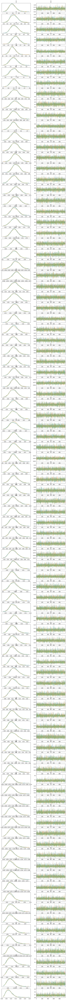

In [10]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [14]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
exact_multicat_intervals = []

for j in range(num_categories):
    exact_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], axis=0),
        'Lower bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 2. Imperfect Contact Tracing + Desaggregated data + Poisson Branching process with multiple categories

In [15]:
approx_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/approx_multicat.stan'))

approx_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

13:21:19 - cmdstanpy - INFO - compiling stan file /var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/tmpkqr7ghp_/tmppaqiu5m9.stan to exe file /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/approx_multicat
13:21:32 - cmdstanpy - INFO - compiled model executable: /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/approx_multicat
/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_23591/2726440678.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [16]:
fit = approx_multicat_model.sample(data=approx_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:21:33 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▉         | 01:45 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 02:47 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 03:37 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 04:24 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 05:20 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 06:13 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 07:02 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 08:01 Iteration:  700 / 2000 [ 35%]  (Warmup)

chain 1 |████▌     | 08:55 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▍    | 09:49 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 10:52 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 12:04 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 13:01 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 13:49 Iter


13:43:19 - cmdstanpy - INFO - CmdStan done processing.
13:43:19 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive f

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.635,0.123,0.403,0.865,0.002,0.001,3829.0,1778.0,1.0
R[1],0.599,0.103,0.427,0.804,0.002,0.001,4489.0,2126.0,1.0
R[2],0.574,0.089,0.410,0.746,0.001,0.001,4363.0,2273.0,1.0
R[3],0.558,0.078,0.412,0.698,0.001,0.001,3758.0,1830.0,1.0
R[4],0.530,0.072,0.406,0.671,0.001,0.001,4451.0,2247.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.083,0.031,0.026,0.139,0.000,0.000,3793.0,1705.0,1.0
R[89],0.098,0.035,0.039,0.163,0.001,0.000,3644.0,1797.0,1.0
R[90],0.089,0.033,0.028,0.146,0.001,0.000,4264.0,2055.0,1.0
R[91],0.079,0.032,0.023,0.137,0.000,0.000,4265.0,1854.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

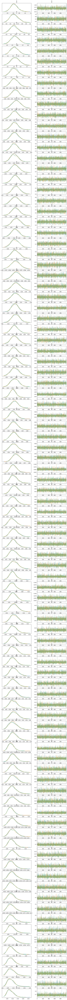

In [17]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [18]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
approx_multicat_intervals = []

for j in range(num_categories):
    approx_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 3. Imperfect Contact Tracing + Aggregated data + Poisson Branching process with multiple categories

In [8]:
agg_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/agg_multicat.stan'))

agg_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

14:17:35 - cmdstanpy - INFO - compiling stan file /var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/tmplo854mo1/tmp6pg80l0e.stan to exe file /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/agg_multicat
14:17:56 - cmdstanpy - INFO - compiled model executable: /Users/ioaros/Desktop/Software Project/branchpro/branchpro/stan_models/agg_multicat
/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_27498/3052504579.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [9]:
fit = agg_multicat_model.sample(data=agg_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

14:17:57 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▍         | 00:00 Status

array([[<AxesSubplot:title={'center':'R\n0'}>,
        <AxesSubplot:title={'center':'R\n0'}>],
       [<AxesSubplot:title={'center':'R\n1'}>,
        <AxesSubplot:title={'center':'R\n1'}>],
       [<AxesSubplot:title={'center':'R\n2'}>,
        <AxesSubplot:title={'center':'R\n2'}>],
       [<AxesSubplot:title={'center':'R\n3'}>,
        <AxesSubplot:title={'center':'R\n3'}>],
       [<AxesSubplot:title={'center':'R\n4'}>,
        <AxesSubplot:title={'center':'R\n4'}>],
       [<AxesSubplot:title={'center':'R\n5'}>,
        <AxesSubplot:title={'center':'R\n5'}>],
       [<AxesSubplot:title={'center':'R\n6'}>,
        <AxesSubplot:title={'center':'R\n6'}>],
       [<AxesSubplot:title={'center':'R\n7'}>,
        <AxesSubplot:title={'center':'R\n7'}>],
       [<AxesSubplot:title={'center':'R\n8'}>,
        <AxesSubplot:title={'center':'R\n8'}>],
       [<AxesSubplot:title={'center':'R\n9'}>,
        <AxesSubplot:title={'center':'R\n9'}>],
       [<AxesSubplot:title={'center':'R\n10'}>,
  

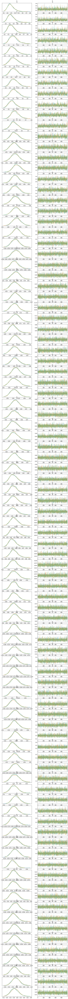

In [ ]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

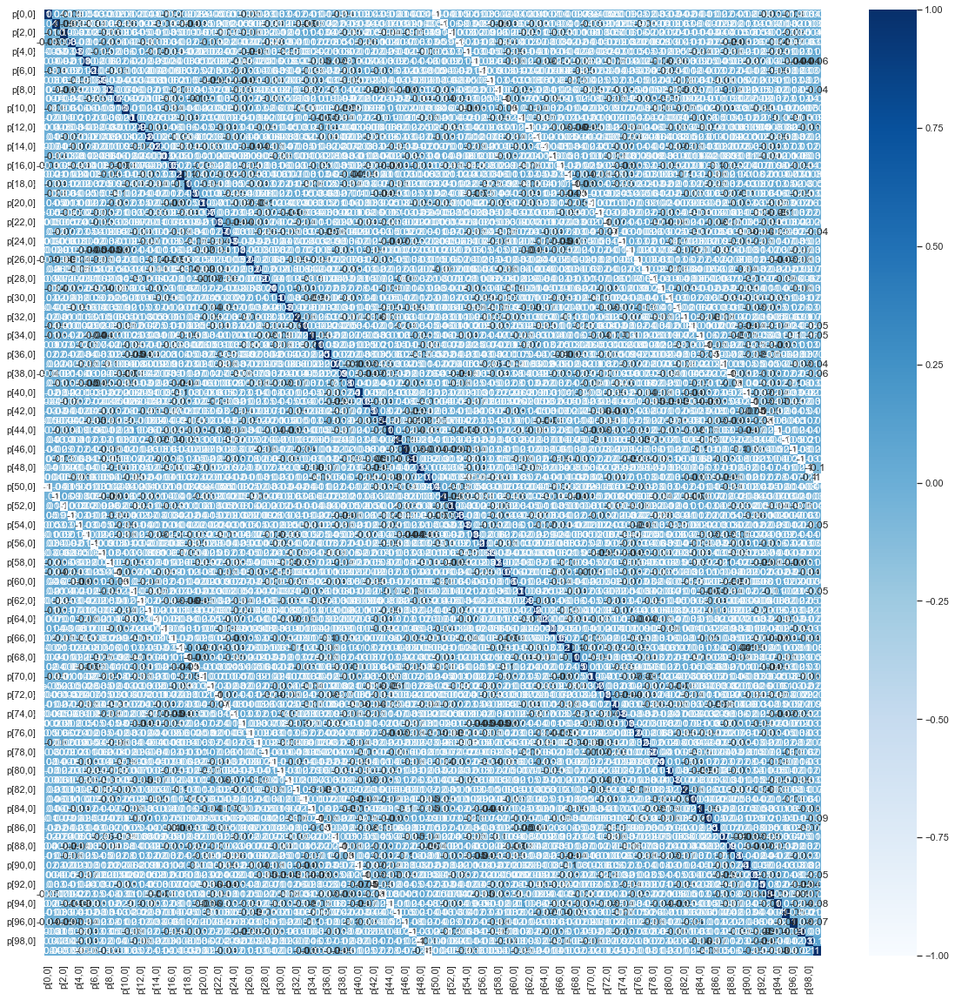

In [ ]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
p_chain_samples = fit.draws()[500:, :, (num_timepoints - R_t_start +7)::num_categories]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = p_chain_samples.shape

extended_p_samples = np.concatenate((
    p_chain_samples[:, 0, :],
    p_chain_samples[:, 1, :],
    p_chain_samples[:, 2, :]), axis=0)

df = pd.DataFrame(
    np.transpose(extended_p_samples),
    columns=[
        'p[{},0]'.format(_)
        for _ in range(num_timepoints)])

plt.figure(figsize=(20,20))
sns.set_theme(style="white")
corr = df.corr()
heatmap = sns.heatmap(corr, annot=True, cmap="Blues", fmt='.1g')

In [ ]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit._draws[500:, :, 7:(num_timepoints - R_t_start +7)]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
agg_multicat_intervals = []

for j in range(num_categories):
    agg_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 4. Aggregated data + Poisson Branching process

In [ ]:
poisson_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/poisson_one.stan'))

poisson_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_39546/1887272557.py:54: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [ ]:
fit = poisson_model.sample(
    data=poisson_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

Building...



Building: found in cache, done.Messages from stanc:
    provided, or the prior(s) depend on data variables. In the later case,
    this may be a false positive.
Sampling:   0%
Sampling:   0% (1/6000)
Sampling:   0% (2/6000)
Sampling:   0% (3/6000)
Sampling:   2% (102/6000)
Sampling:   3% (201/6000)
Sampling:   5% (300/6000)
Sampling:   7% (400/6000)
Sampling:   8% (500/6000)
Sampling:  10% (600/6000)
Sampling:  12% (700/6000)
Sampling:  13% (800/6000)
Sampling:  15% (900/6000)
Sampling:  17% (1000/6000)
Sampling:  18% (1100/6000)
Sampling:  20% (1200/6000)
Sampling:  22% (1300/6000)
Sampling:  23% (1400/6000)
Sampling:  25% (1500/6000)
Sampling:  27% (1600/6000)
Sampling:  28% (1700/6000)
Sampling:  30% (1800/6000)
Sampling:  32% (1900/6000)
Sampling:  33% (2000/6000)
Sampling:  35% (2100/6000)
Sampling:  37% (2200/6000)
Sampling:  38% (2300/6000)
Sampling:  40% (2400/6000)
Sampling:  42% (2500/6000)
Sampling:  43% (2600/6000)
Sampling:  45% (2700/6000)
Sampling:  63% (3800/6000)
Samp

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],2.010,0.567,1.035,3.113,0.008,0.006,4700.0,1973.0,1.0
R[1],2.356,0.522,1.377,3.308,0.008,0.005,4704.0,2301.0,1.0
R[2],2.682,0.501,1.782,3.611,0.007,0.005,5164.0,2053.0,1.0
R[3],2.850,0.502,1.837,3.706,0.007,0.005,5102.0,2150.0,1.0
R[4],3.435,0.492,2.530,4.350,0.007,0.005,4673.0,1869.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],1.313,0.158,1.032,1.608,0.002,0.002,4488.0,1685.0,1.0
R[89],1.312,0.157,0.991,1.579,0.003,0.002,3854.0,1992.0,1.0
R[90],1.234,0.149,0.965,1.514,0.002,0.001,5149.0,2057.0,1.0
R[91],1.061,0.137,0.795,1.309,0.002,0.002,3763.0,2070.0,1.0


array([[<AxesSubplot:title={'center':'R\n0'}>,
        <AxesSubplot:title={'center':'R\n0'}>],
       [<AxesSubplot:title={'center':'R\n1'}>,
        <AxesSubplot:title={'center':'R\n1'}>],
       [<AxesSubplot:title={'center':'R\n2'}>,
        <AxesSubplot:title={'center':'R\n2'}>],
       [<AxesSubplot:title={'center':'R\n3'}>,
        <AxesSubplot:title={'center':'R\n3'}>],
       [<AxesSubplot:title={'center':'R\n4'}>,
        <AxesSubplot:title={'center':'R\n4'}>],
       [<AxesSubplot:title={'center':'R\n5'}>,
        <AxesSubplot:title={'center':'R\n5'}>],
       [<AxesSubplot:title={'center':'R\n6'}>,
        <AxesSubplot:title={'center':'R\n6'}>],
       [<AxesSubplot:title={'center':'R\n7'}>,
        <AxesSubplot:title={'center':'R\n7'}>],
       [<AxesSubplot:title={'center':'R\n8'}>,
        <AxesSubplot:title={'center':'R\n8'}>],
       [<AxesSubplot:title={'center':'R\n9'}>,
        <AxesSubplot:title={'center':'R\n9'}>],
       [<AxesSubplot:title={'center':'R\n10'}>,
  

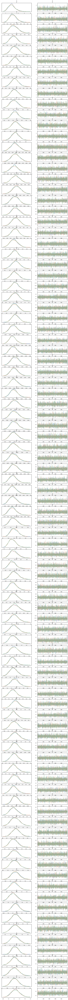

In [ ]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [ ]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))

pois_intervals = pd.DataFrame({
    'Time Points': np.arange(R_t_start, num_timepoints),
    'Mean': np.mean(extended_samples[::thinning, :], axis=0),
    'Lower bound CI': np.quantile(extended_samples[::thinning, :], 0.025, axis=0),
    'Upper bound CI': np.quantile(extended_samples[::thinning, :], 0.975, axis=0),
    'Central Probability': (L1+L2+L3) * [0.95]
})

## Inference plot using class method results

In [ ]:
fig = ReproductionNumberPlot()

for j in range(num_categories):
    fig.add_ground_truth_rt(ground_truth[j], shape=[None, 'dash'][j])
    fig.add_interval_rt(exact_multicat_intervals[j], shape=[None, 'dash'][j], model_type='exact_contact_tracing multi_categorical')
    fig.add_interval_rt(approx_multicat_intervals[j], colour='red', shape=[None, 'dash'][j], model_type='approximate_contact_tracing multi_categorical')
    fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', shape=[None, 'dash'][j], model_type='agg_multi_categorical')
fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='uniform poisson term')
    
fig.update_labels(time_label='Time (Day)', r_label='R_t')

fig.show_figure()